In [3]:
# Importando módulos
import nltk
from nltk.corpus import stopwords
import numpy as np
import pandas as pd
import fitz
import re
import spacy
import seaborn as sns

from PIL import Image
import matplotlib.pyplot as plt
from wordcloud import WordCloud, ImageColorGenerator
from datetime import datetime as DateTime

# Configurando los estílos de los gráficos
plt.ioff()
sns.set_context('talk')
sns.set_style("whitegrid")

# Configurando los estílos de los gráficos
plt.ioff()
sns.set_context('talk')
sns.set_style("whitegrid")

In [4]:

_spanish_stopwords = stopwords.words('spanish') + ['ama', 'sua', 'llulla', 'quella', 'perú', 's/', 'si', 'año', 'años', 'país', 'peruano', 'https', 'gob', 'pe', 'p.','2020','2020a','2019', 'además', '2020.', '2018', '2020.', '--', 'así','2.','nº','1.','10','20','15','30','2017','100', '2020b', 'iii','según', 'http', 'pdf', '65', 'nacional', 'política', 'podemos', 'solo', 'sólo', 'ello', 'peruanos', 'mayor', '2021', 'fin', 'ley', 'plan', 'toda', 'todo', 'todas', 'todos', 'aquí', 'allá', 'entre', 'veces', 'menos', 'más', 'países', 'desarrollo', 'millones', 'mundo', 'salud', 'dejar', 'días', 'día', 'sistema', 'debe', 'objetivo', 'personas', 'propuesta', 'través' , 'tener', 'primeros', 'bibliografía', 'políticas', 'primero', 'segundo', 'tercero', 'covid-19', 'manera', 'pandemia', 'doctrina', 'gobierno', 'nivel', 'niveles', 'caso', 'probabilidades', 'proporcionan', 'poner', '.', 'pensión', 'forma', 'formas', 'particular', 'enfoque', 'indicador', 'gasto', 'falta', 'número', '2021-2026', 'www.somosperu.pe', 'partido', 'torre', 'catalina', 'victoria', 'gestión']

## Transformación de Datos

In [5]:
docsDir = os.listdir('data/plans')
print(docsDir)

['Acción Popular.pdf', 'Alianza para el Progreso.pdf', 'Avanza País.pdf', 'Democracia Directa.pdf', 'Frente Amplio.pdf', 'Fuerza Popular.pdf', 'Juntos por El Perú.pdf', 'Partido Morado.pdf', 'Partido Nacionalista Peruano.pdf', 'Partido Popular Cristiano.pdf', 'Perú Libre.pdf', 'Perú Patria Segura.pdf', 'Podemos Perú.pdf', 'Renovacion Popular.pdf', 'Somos Perú.pdf', 'Unión Por el Perú.pdf', 'Victoria Nacional.pdf']


In [6]:
spacy.prefer_gpu()
nlp = spacy.load("es_core_news_sm")

_documents = []

for i in range(len(docsDir)):
    docPath = f'data/plans/{docsDir[i]}'
    text = ""

    print(docPath + ' (0%)')
    with fitz.open(docPath) as doc:
        for page in doc:
            pageText = page.getText()

            if '...................................' in pageText:
                continue

            pageText = pageText.lower()
            pageText = pageText.replace('.gob.pe','').replace('.pdf','').replace('plan de gobierno','').replace('partido morado', '').replace('https', '')

            text += ' ' + pageText

    print(docPath + ' (25%)')
    tokens = nlp(text)
    df = pd.DataFrame([(w.text, w.pos_) for w in tokens])
    nouns = df[df[1]=='NOUN'][0].tolist()
    verbs = df[df[1]=='VERB'][0].tolist()
    propns = list(map(str.lower,df[df[1]=='PROPN'][0].tolist()))

    nouns_cleaned = [word for word in nouns if word not in _spanish_stopwords and len(word) > 3 and re.match(r'^([\s\d]+)$', word) is None]
    verbs_cleaned = [word for word in verbs if word not in _spanish_stopwords and len(word) > 3 and re.match(r'^([\s\d]+)$', word) is None]
    propns_cleaned = [word for word in propns if word not in _spanish_stopwords and len(word) > 3 and re.match(r'^([\s\d]+)$', word) is None]

    words_cleaned = nouns_cleaned + verbs_cleaned + propns_cleaned
    text_cleaned = ' '.join(words_cleaned)

    common_words = nltk.FreqDist(words_cleaned).most_common(7)
    text_compressed = ", ".join(pd.DataFrame(common_words)[0].tolist())

    _documents.append((docPath, words_cleaned, text_cleaned, common_words, text_compressed, docsDir[i][0:-4]))

    print(docPath + ' (100%)')
    print()

data/plans/Acción Popular.pdf (0%)
data/plans/Acción Popular.pdf (25%)
data/plans/Acción Popular.pdf (100%)

data/plans/Alianza para el Progreso.pdf (0%)
data/plans/Alianza para el Progreso.pdf (25%)
data/plans/Alianza para el Progreso.pdf (100%)

data/plans/Avanza País.pdf (0%)
data/plans/Avanza País.pdf (25%)
data/plans/Avanza País.pdf (100%)

data/plans/Democracia Directa.pdf (0%)
data/plans/Democracia Directa.pdf (25%)
data/plans/Democracia Directa.pdf (100%)

data/plans/Frente Amplio.pdf (0%)
data/plans/Frente Amplio.pdf (25%)
data/plans/Frente Amplio.pdf (100%)

data/plans/Fuerza Popular.pdf (0%)
data/plans/Fuerza Popular.pdf (25%)
data/plans/Fuerza Popular.pdf (100%)

data/plans/Juntos por El Perú.pdf (0%)
data/plans/Juntos por El Perú.pdf (25%)
data/plans/Juntos por El Perú.pdf (100%)

data/plans/Partido Morado.pdf (0%)
data/plans/Partido Morado.pdf (25%)
data/plans/Partido Morado.pdf (100%)

data/plans/Partido Nacionalista Peruano.pdf (0%)
data/plans/Partido Nacionalista Perua

## Visualización de Datos

In [11]:
def showCloud(title, imageSource, words_cleaned, text_cleaned, common_words, common_words_text):
    # Resumen
    print('Text Size (Clean): %s' % len(text_cleaned))
    print('Words Count (Clean): %s' % len(words_cleaned))
    print()
    for common_word in common_words:
        print("%s: %s veces (%s%s)" % (common_word[0], common_word[1], round(common_word[1] * 100 / len(words_cleaned), 2), ' %'))
    print()

    plt.clf()

    # Generamos el WordCloud
    mask = np.array(Image.open(imageSource))
    planCloud = WordCloud(background_color="white", mode="RGBA", max_words=1000, mask=mask).generate(text_cleaned)

    # Graficamos
    fig = plt.figure(figsize=[20,20])
    plt.figtext(0.125,0.95, title.upper() + ': ELECCIONES GENERALES DE PERÚ DE 2021', ha='left', fontsize=24)
    plt.figtext(0.125,0.925, 'WordCloud de Plan de Gobierno', ha='left', fontsize=20, color='#999')
    plt.figtext(0.875,0.02, """Fuente: https://votoinformado.jne.gob.pe/voto/Home/ListaOP
    Autor: https://malexandersalazar.github.io/, Moisés Alexander Salazar Vila, """ + f'{DateTime.now():%Y-%m-%d}', ha='right')

    # Incrustamos el WordCloud en el gráfico
    plt.imshow(planCloud.recolor(color_func=ImageColorGenerator(mask)), interpolation="bilinear")
    plt.axis("off")

    # Guardamos y generamos el Markdown para las imágenes
    filename = 'dist/{}.jpg'.format(title.replace(' ', '_'))
    plt.savefig('../' + filename, format='jpg', bbox_inches='tight', pil_kwargs={'quality': 100})
    with open("../dist/_images.txt", "a", encoding='utf-8') as f:
        f.write('![alt text]({} "{}")\n'.format(filename, title))
        f.write('Palabras clave: ' + common_words_text + '\n\n')
        

    plt.show() 
    plt.close(fig)

In [12]:
for document in _documents:
    print(document[-1] + ': ' + document[4])

Acción Popular: trabajar, honestidad, pensiones, reinstalar, reforma, acción, empresas
Alianza para el Progreso: empresas, inversión, agua, educación, recursos, proyectos, servicios
Avanza País: inversión, infraestructura, servicios, programas, protección, corrupción, creación
Democracia Directa: educación, población, ministerio, presupuesto, instituto, servicios, entidades
Frente Amplio: implementación, medidas, educación, programa, incremento, porcentaje, recursos
Fuerza Popular: educación, servicios, pobreza, sector, población, programas, acceso
Juntos por El Perú: derechos, educación, fortalecer, capacidades, género, servicios, participación
Partido Morado: servicios, calidad, educación, vida, acceso, instituciones, información
Partido Nacionalista Peruano: programa, población, proyectos, servicios, reforma, fortalecer, establecer
Partido Popular Cristiano: derechos, convención, humanos, discriminación, igualdad, pesem, persona
Perú Libre: programa, educación, empresas, capítulo, s

In [13]:
inputs = [
    ('Acción Popular', 'data\logos\logo_accion_popular.jpg'),
    ('Alianza para el Progreso', 'data\logos\logo_alianza_para_el_progreso.png'),
    ('Avanza País', 'data\logos\logo_avanza_pais.jpg'),
    ('Democracia Directa', 'data\logos\logo_democracia_directa.jpg'),
    ('Frente Amplio', 'data\logos\logo_frente_amplio.jpg'),
    ('Fuerza Popular', 'data\logos\logo_fuerza_popular.jpg'),
    ('Juntos por El Perú', 'data\logos\logo_juntos_por_el_peru.jpg'),
    ('Partido Morado', 'data\logos\logo_partido_morado.jpg'),
    ('Partido Nacionalista Peruano', 'data\logos\logo_partido_nacionalista_peruano.jpg'),
    ('Partido Popular Cristiano', 'data\logos\logo_partido_popular_cristiano.png'),
    ('Perú Libre', 'data\logos\logo_peru_libre.jpg'),
    ('Perú Patria Segura', 'data\logos\logo_peru_patria_segura.jpg'),
    ('Podemos Perú', 'data\logos\logo_podemos_peru.jpg'),
    ('Renovacion Popular', 'data\logos\logo_renovacion_popular.png'),
    ('Somos Perú', 'data\logos\logo_somos_peru.png'),
    ('Unión Por el Perú', 'data\logos\logo_union_por_el_peru.jpg'),
    ('Victoria Nacional', 'data\logos\logo_victoria_nacional.jpg')
]

Text Size (Clean): 30878
Words Count (Clean): 3340

trabajar: 58 veces (1.74 %)
honestidad: 28 veces (0.84 %)
pensiones: 28 veces (0.84 %)
reinstalar: 26 veces (0.78 %)
reforma: 23 veces (0.69 %)
acción: 19 veces (0.57 %)
empresas: 16 veces (0.48 %)



<Figure size 432x288 with 0 Axes>

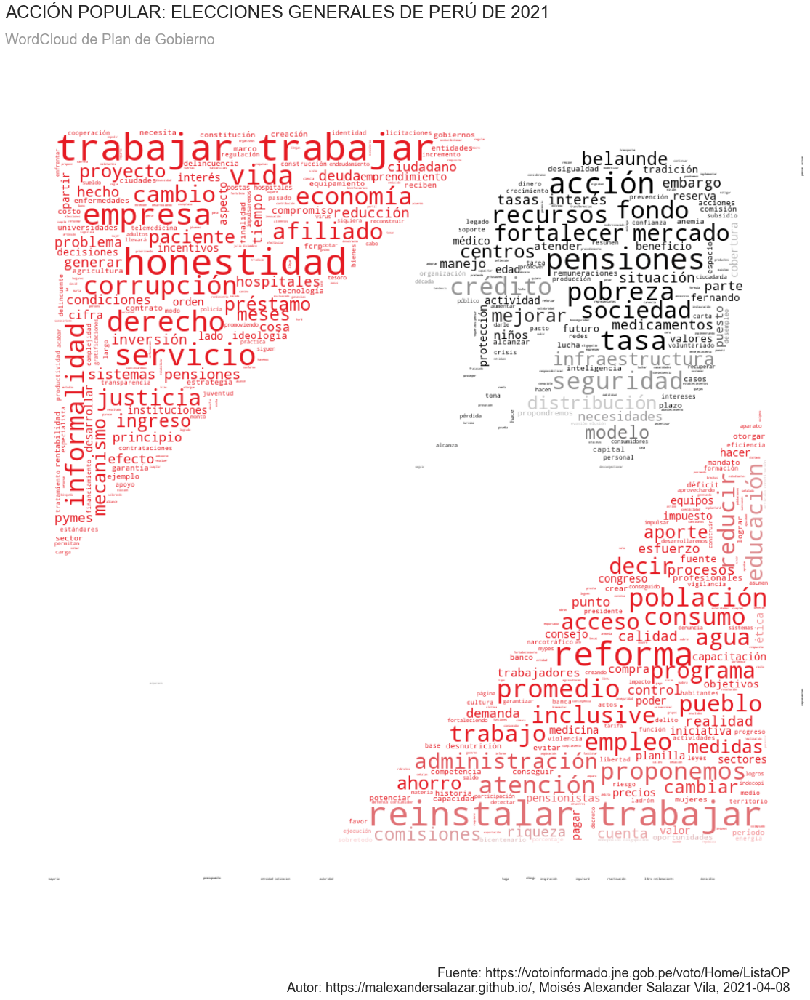

Text Size (Clean): 256459
Words Count (Clean): 27131

empresas: 181 veces (0.67 %)
inversión: 166 veces (0.61 %)
agua: 142 veces (0.52 %)
educación: 137 veces (0.5 %)
recursos: 131 veces (0.48 %)
proyectos: 127 veces (0.47 %)
servicios: 108 veces (0.4 %)



<Figure size 432x288 with 0 Axes>

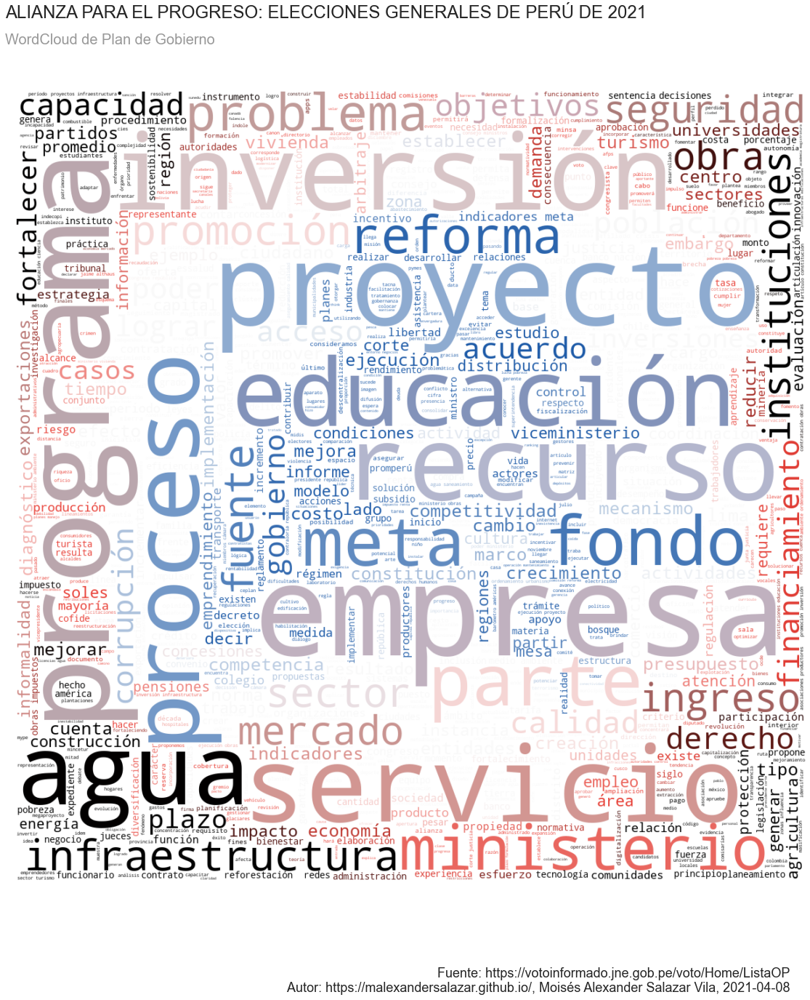

Text Size (Clean): 20524
Words Count (Clean): 2107

inversión: 17 veces (0.81 %)
infraestructura: 16 veces (0.76 %)
servicios: 15 veces (0.71 %)
programas: 14 veces (0.66 %)
protección: 13 veces (0.62 %)
corrupción: 13 veces (0.62 %)
creación: 12 veces (0.57 %)



<Figure size 432x288 with 0 Axes>

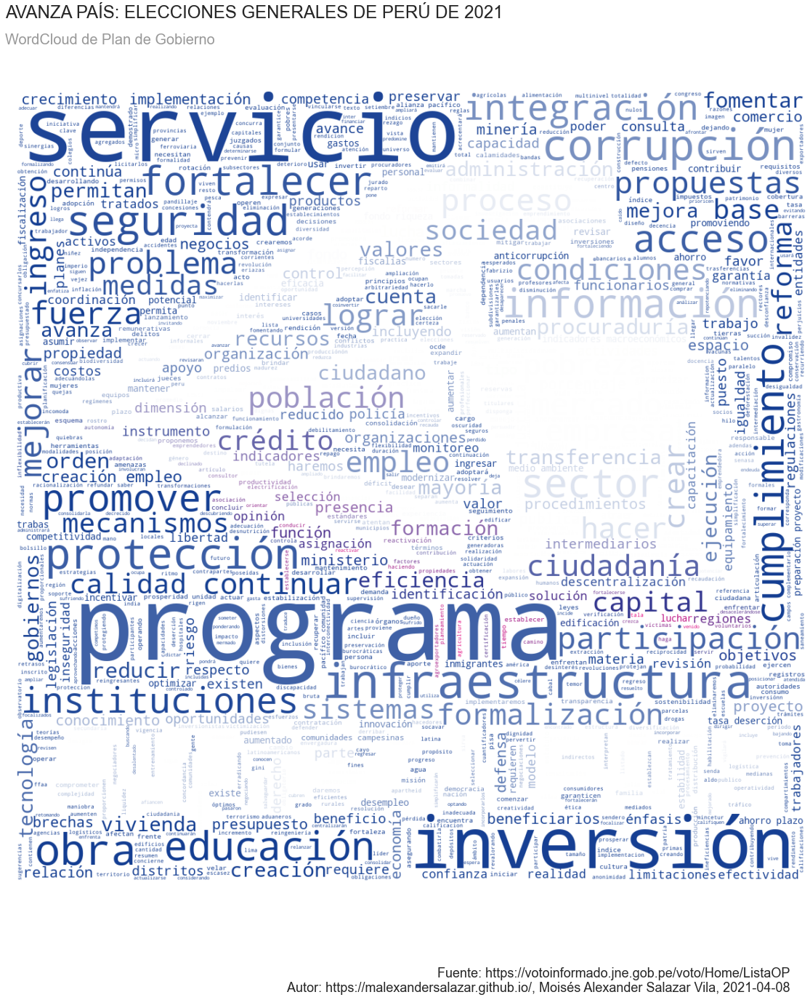

Text Size (Clean): 72715
Words Count (Clean): 7342

educación: 137 veces (1.87 %)
población: 88 veces (1.2 %)
ministerio: 87 veces (1.18 %)
presupuesto: 73 veces (0.99 %)
instituto: 65 veces (0.89 %)
servicios: 59 veces (0.8 %)
entidades: 53 veces (0.72 %)



<Figure size 432x288 with 0 Axes>

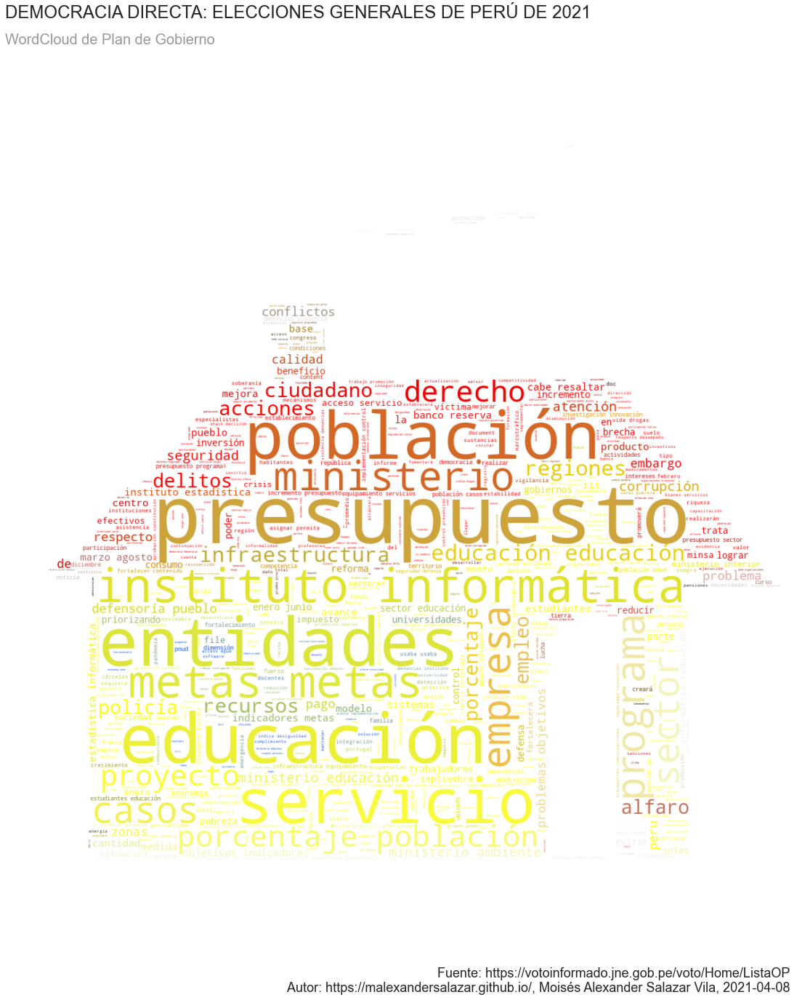

Text Size (Clean): 79116
Words Count (Clean): 8082

implementación: 84 veces (1.04 %)
medidas: 59 veces (0.73 %)
educación: 58 veces (0.72 %)
programa: 56 veces (0.69 %)
incremento: 54 veces (0.67 %)
porcentaje: 52 veces (0.64 %)
recursos: 49 veces (0.61 %)



<Figure size 432x288 with 0 Axes>

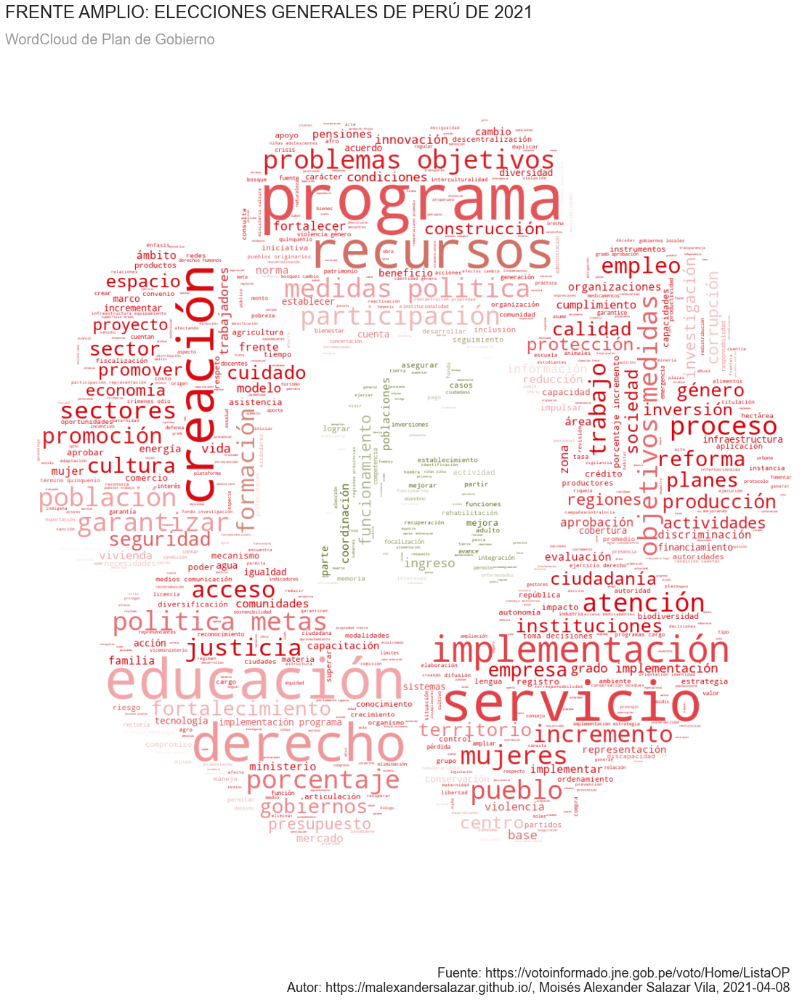

Text Size (Clean): 95688
Words Count (Clean): 10030

educación: 64 veces (0.64 %)
servicios: 64 veces (0.64 %)
pobreza: 55 veces (0.55 %)
sector: 51 veces (0.51 %)
población: 48 veces (0.48 %)
programas: 45 veces (0.45 %)
acceso: 45 veces (0.45 %)



<Figure size 432x288 with 0 Axes>

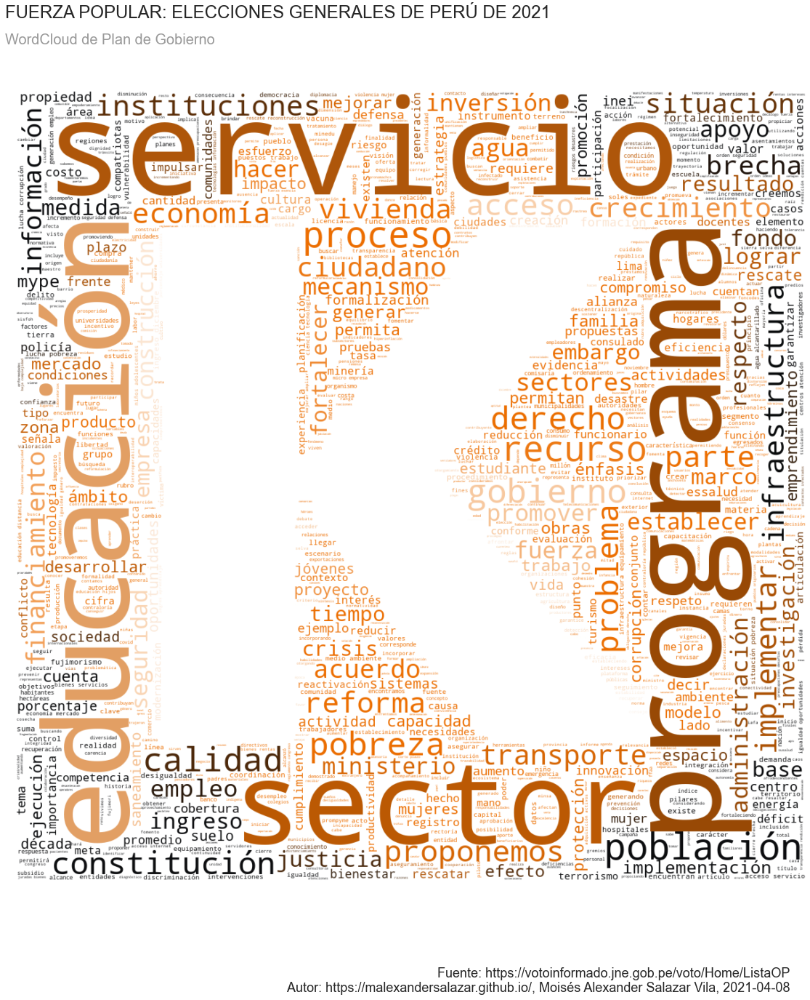

Text Size (Clean): 87857
Words Count (Clean): 8921

derechos: 76 veces (0.85 %)
educación: 65 veces (0.73 %)
fortalecer: 50 veces (0.56 %)
capacidades: 48 veces (0.54 %)
género: 48 veces (0.54 %)
servicios: 48 veces (0.54 %)
participación: 45 veces (0.5 %)



<Figure size 432x288 with 0 Axes>

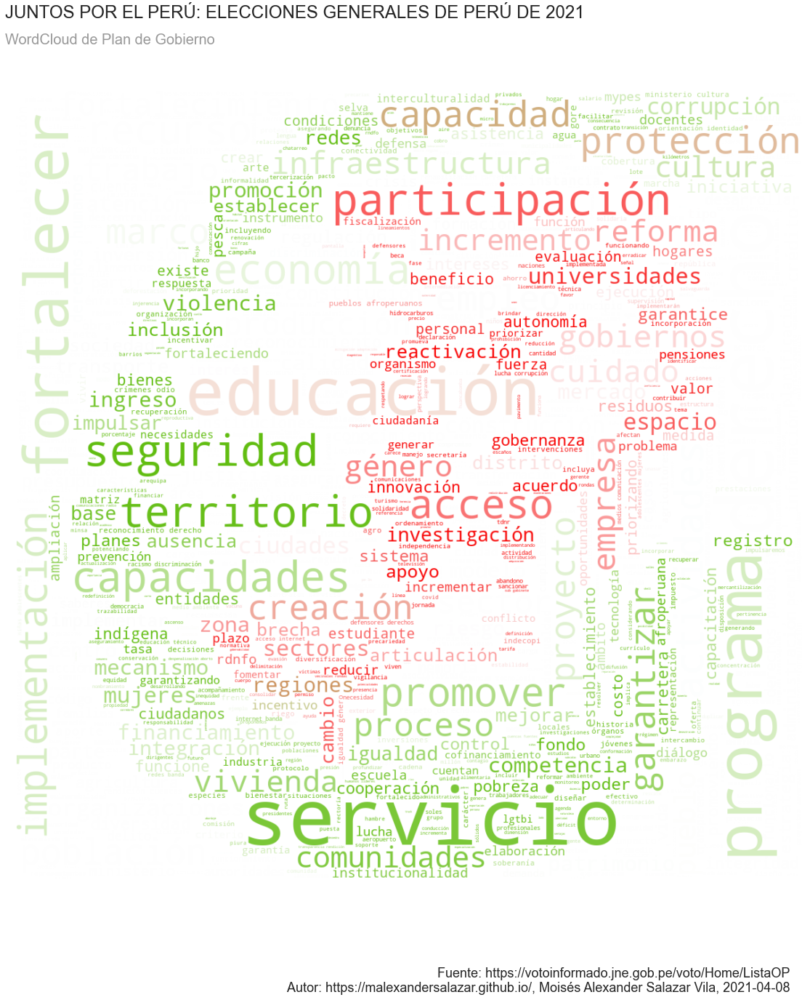

Text Size (Clean): 158883
Words Count (Clean): 16378

servicios: 136 veces (0.83 %)
calidad: 112 veces (0.68 %)
educación: 98 veces (0.6 %)
vida: 80 veces (0.49 %)
acceso: 79 veces (0.48 %)
instituciones: 75 veces (0.46 %)
información: 75 veces (0.46 %)



<Figure size 432x288 with 0 Axes>

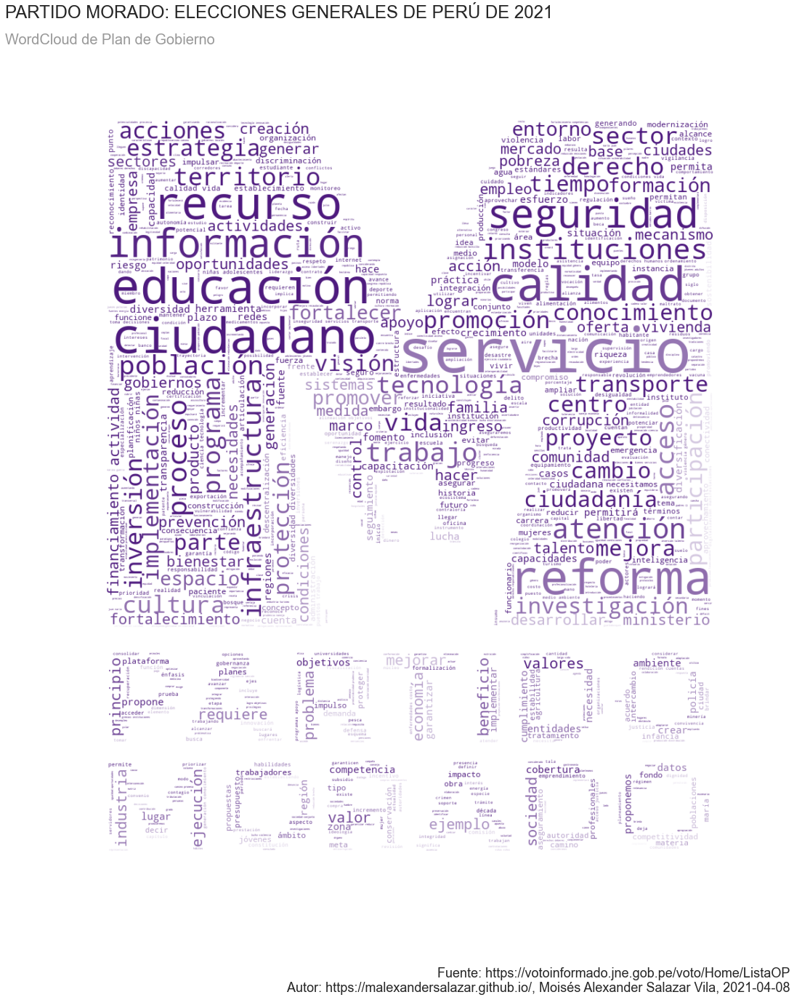

Text Size (Clean): 61321
Words Count (Clean): 6495

programa: 40 veces (0.62 %)
población: 39 veces (0.6 %)
proyectos: 32 veces (0.49 %)
servicios: 32 veces (0.49 %)
reforma: 31 veces (0.48 %)
fortalecer: 29 veces (0.45 %)
establecer: 29 veces (0.45 %)



<Figure size 432x288 with 0 Axes>

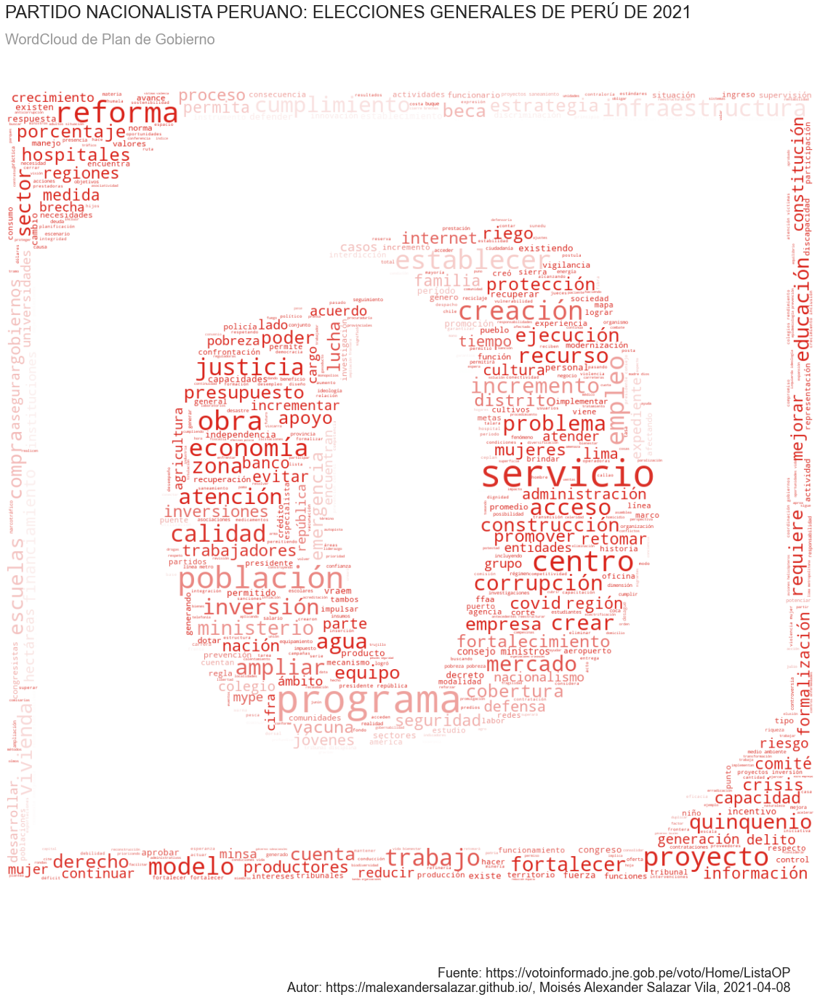

Text Size (Clean): 18662
Words Count (Clean): 1980

derechos: 52 veces (2.63 %)
convención: 39 veces (1.97 %)
humanos: 31 veces (1.57 %)
discriminación: 30 veces (1.52 %)
igualdad: 22 veces (1.11 %)
pesem: 16 veces (0.81 %)
persona: 14 veces (0.71 %)



<Figure size 432x288 with 0 Axes>

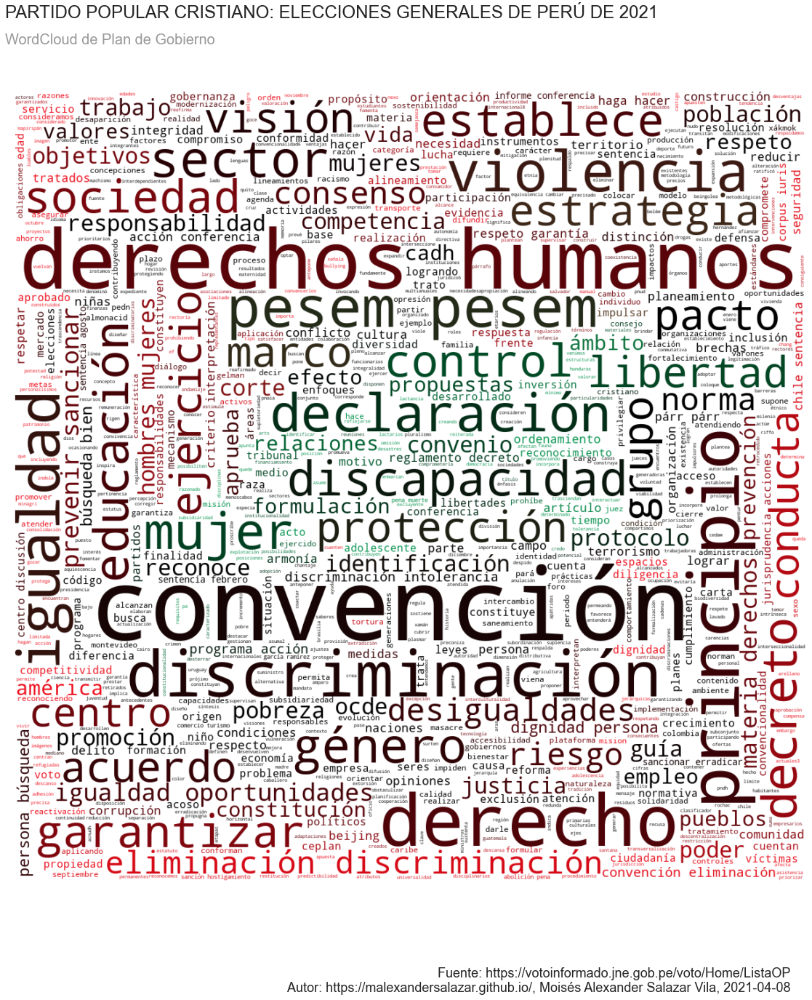

Text Size (Clean): 73238
Words Count (Clean): 7892

programa: 93 veces (1.18 %)
educación: 57 veces (0.72 %)
empresas: 50 veces (0.63 %)
capítulo: 45 veces (0.57 %)
sociedad: 44 veces (0.56 %)
recursos: 43 veces (0.54 %)
sector: 42 veces (0.53 %)



<Figure size 432x288 with 0 Axes>

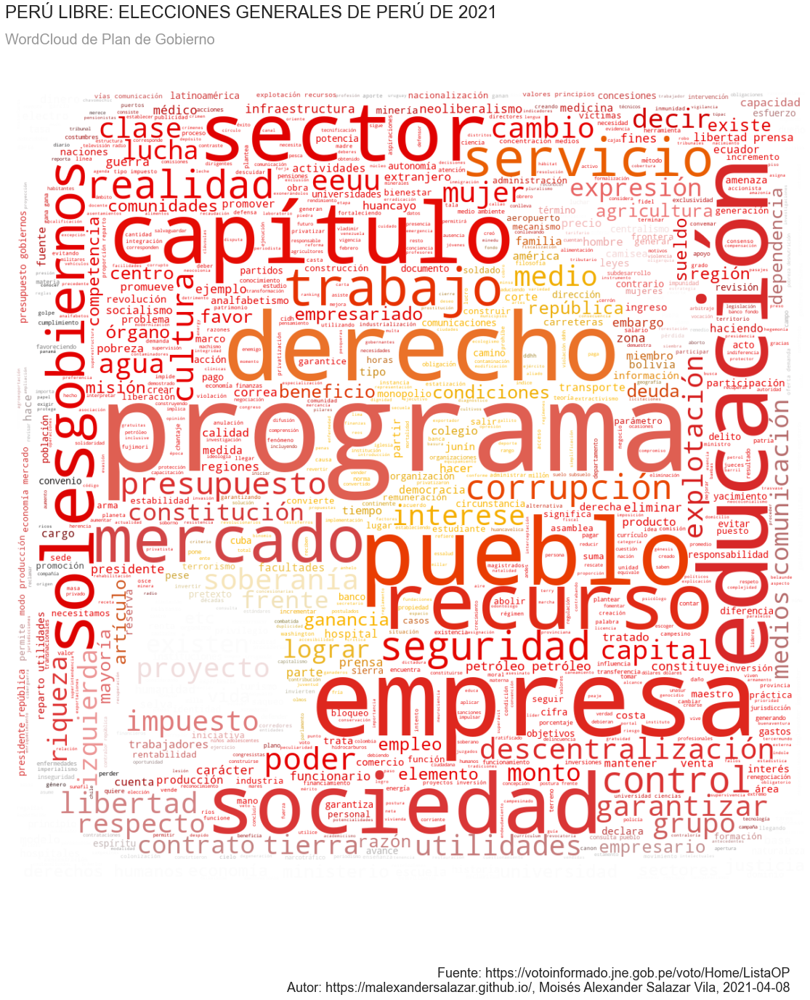

Text Size (Clean): 179942
Words Count (Clean): 18800

justicia: 146 veces (0.78 %)
derechos: 104 veces (0.55 %)
infraestructura: 96 veces (0.51 %)
recursos: 96 veces (0.51 %)
seguridad: 92 veces (0.49 %)
calidad: 90 veces (0.48 %)
sector: 86 veces (0.46 %)



<Figure size 432x288 with 0 Axes>

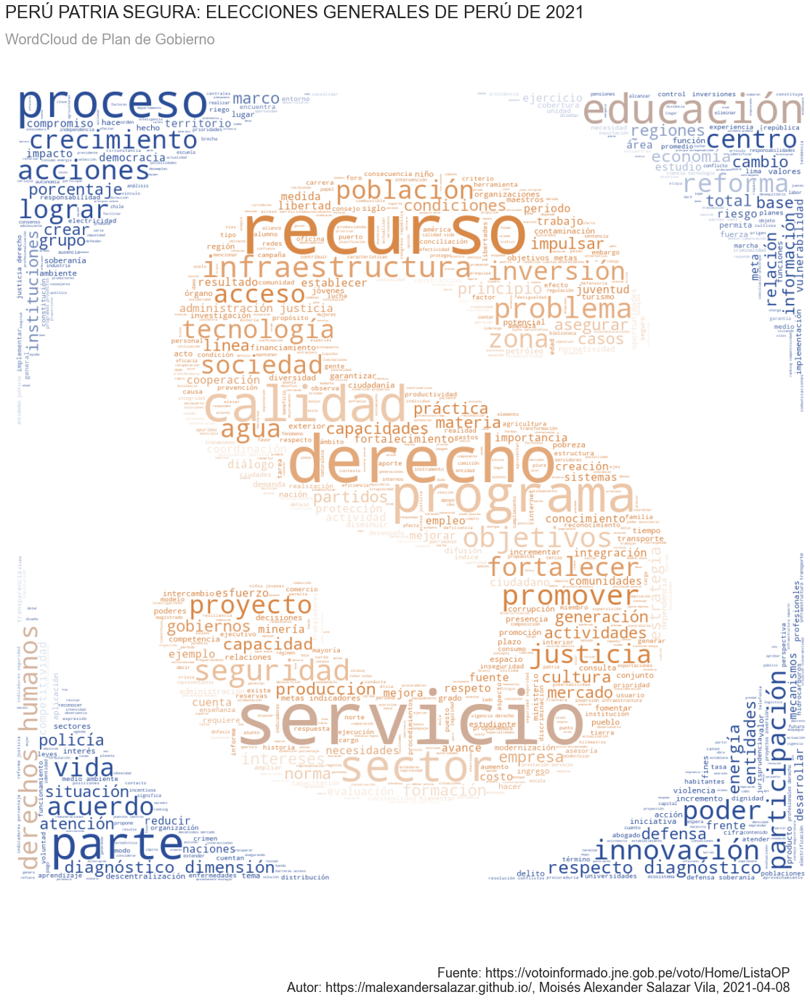

Text Size (Clean): 89734
Words Count (Clean): 9579

educación: 72 veces (0.75 %)
programa: 67 veces (0.7 %)
creación: 66 veces (0.69 %)
servicios: 61 veces (0.64 %)
empresas: 61 veces (0.64 %)
economía: 54 veces (0.56 %)
recursos: 41 veces (0.43 %)



<Figure size 432x288 with 0 Axes>

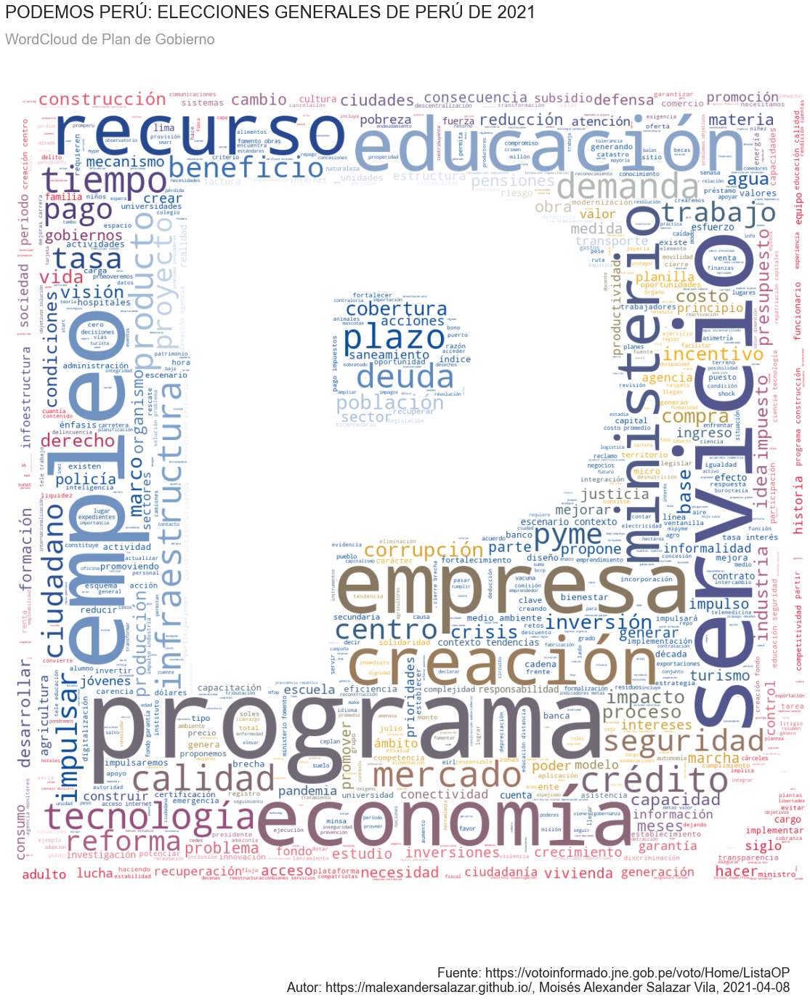

Text Size (Clean): 24667
Words Count (Clean): 2454

promoveremos: 30 veces (1.22 %)
impulsaremos: 27 veces (1.1 %)
productos: 21 veces (0.86 %)
calidad: 18 veces (0.73 %)
zonas: 18 veces (0.73 %)
recursos: 16 veces (0.65 %)
medio: 15 veces (0.61 %)



<Figure size 432x288 with 0 Axes>

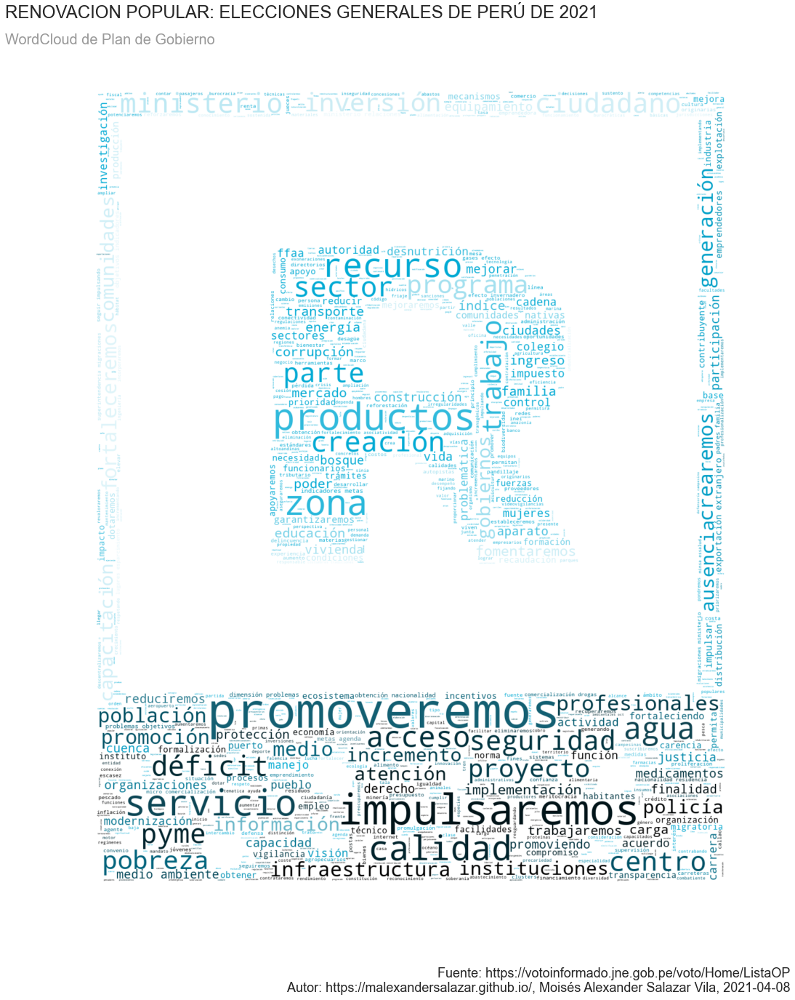

Text Size (Clean): 168138
Words Count (Clean): 17410

población: 124 veces (0.71 %)
metas: 112 veces (0.64 %)
servicios: 109 veces (0.63 %)
indicadores: 108 veces (0.62 %)
sector: 89 veces (0.51 %)
porcentaje: 89 veces (0.51 %)
recursos: 84 veces (0.48 %)



<Figure size 432x288 with 0 Axes>

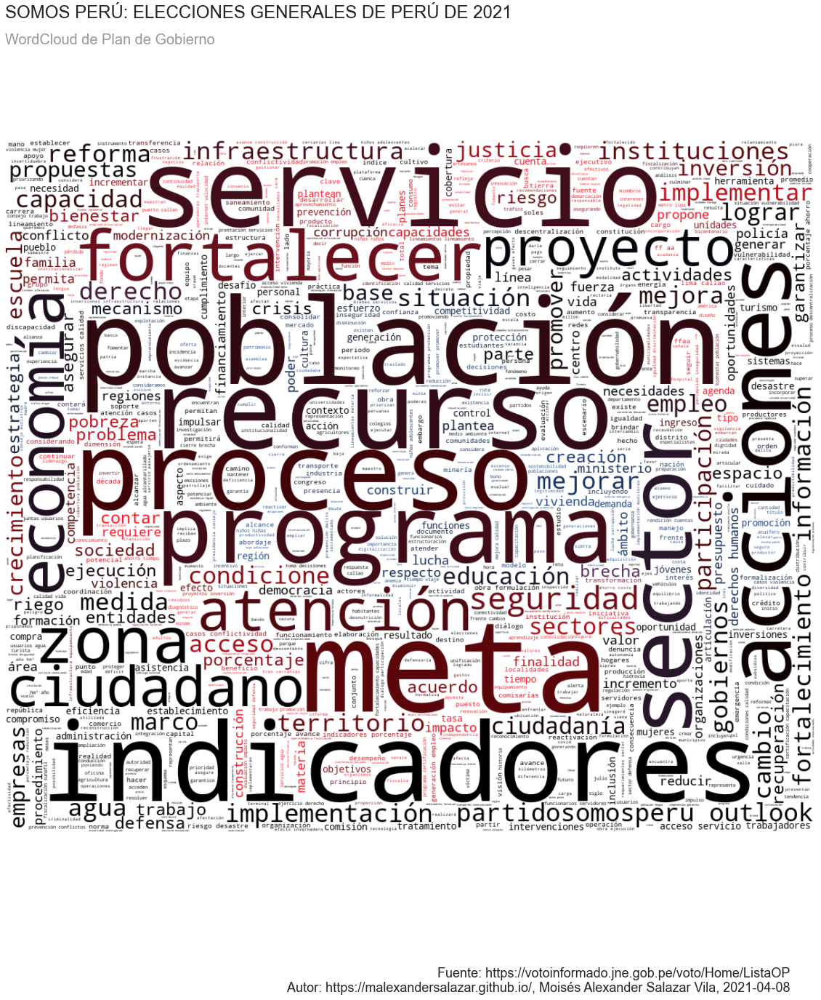

Text Size (Clean): 37004
Words Count (Clean): 3797

educación: 60 veces (1.58 %)
unión: 44 veces (1.16 %)
calidad: 28 veces (0.74 %)
infraestructura: 26 veces (0.68 %)
mejorar: 24 veces (0.63 %)
instituciones: 23 veces (0.61 %)
desarrollar: 22 veces (0.58 %)



<Figure size 432x288 with 0 Axes>

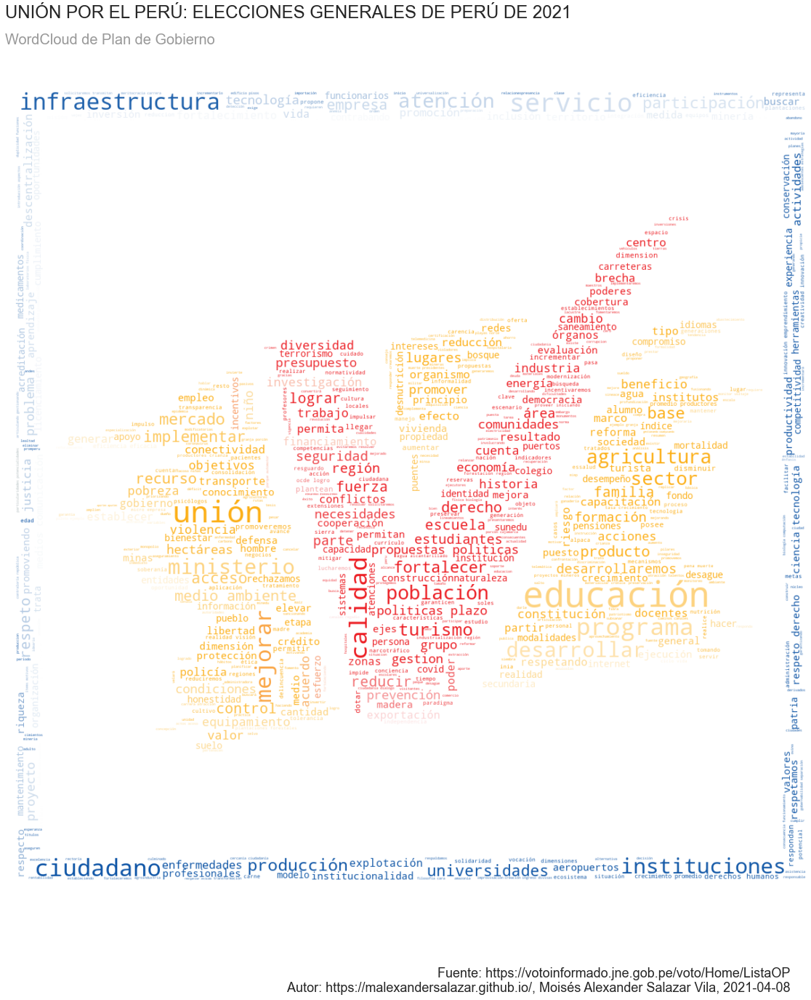

Text Size (Clean): 166498
Words Count (Clean): 17035

objetivos: 124 veces (0.73 %)
educación: 123 veces (0.72 %)
problemas: 118 veces (0.69 %)
indicadores: 118 veces (0.69 %)
metas: 114 veces (0.67 %)
servicios: 108 veces (0.63 %)
inversión: 93 veces (0.55 %)



<Figure size 432x288 with 0 Axes>

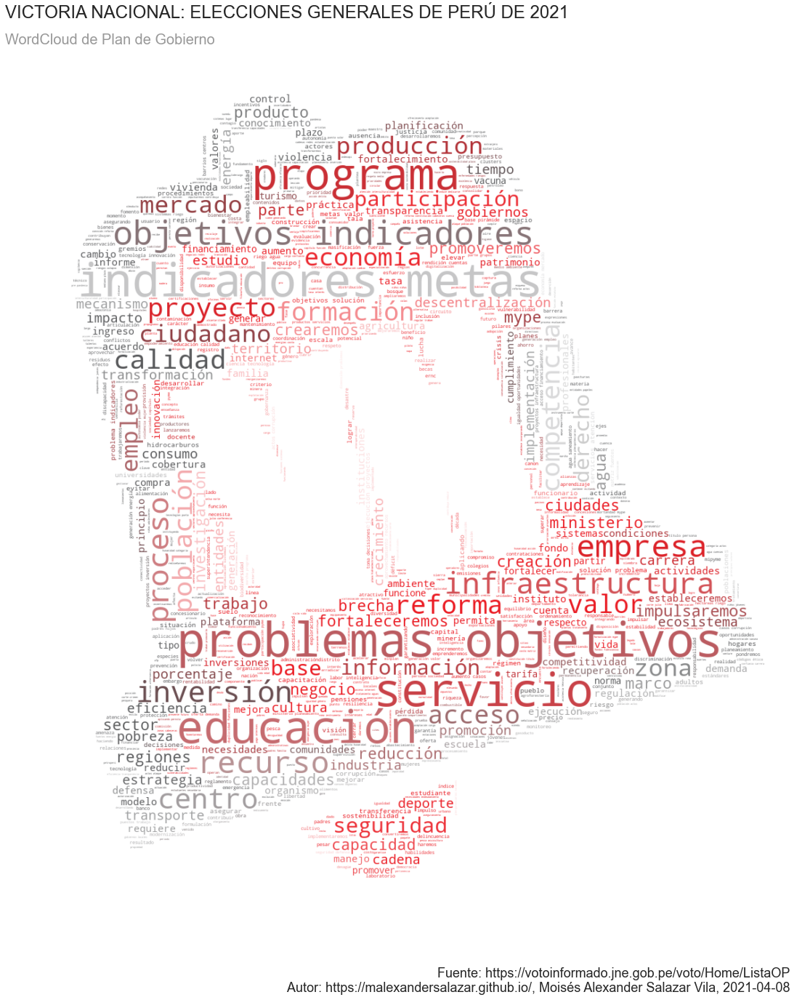

In [14]:
# Eliminando archivo generado para el Markdown de las imágenes
if os.path.exists("../dist/_images.txt"):
    os.remove("../dist/_images.txt")

for i in np.arange(len(inputs)):
    showCloud(inputs[i][0],inputs[i][1], _documents[i][1], _documents[i][2], _documents[i][3], _documents[i][4])